In [1]:
!pip install ultralytics

Looking in indexes: https://pypi.org/simple, https://pypi.ngc.nvidia.com



[notice] A new release of pip is available: 24.0 -> 24.3.1
[notice] To update, run: python.exe -m pip install --upgrade pip


In [2]:
!pip install onnx --upgrade

Looking in indexes: https://pypi.org/simple, https://pypi.ngc.nvidia.com



[notice] A new release of pip is available: 24.0 -> 24.3.1
[notice] To update, run: python.exe -m pip install --upgrade pip


In [3]:
!pip install nvidia-pyindex
!pip install nvidia-tensorrt==<compatible-version>

Looking in indexes: https://pypi.org/simple, https://pypi.ngc.nvidia.com



[notice] A new release of pip is available: 24.0 -> 24.3.1
[notice] To update, run: python.exe -m pip install --upgrade pip
The syntax of the command is incorrect.


In [2]:
import os
current_dir = os.getcwd()

In [5]:
import zipfile
import os
import shutil

current_dir = os.getcwd()

zip_file_path = os.path.join(current_dir, 'dataset.zip')
extract_to = current_dir 

os.makedirs(extract_to, exist_ok=True)

with zipfile.ZipFile(zip_file_path, 'r') as zip_ref:
    zip_ref.extractall(extract_to)

print(f"Files have been extracted to {extract_to}")

Files have been extracted to d:\Traffic-classification-intensity-estimation


In [6]:
import os
import shutil
import random

dataset_path = os.path.join(current_dir, 'train')
output_path = os.path.join(current_dir, 'dataset')

os.makedirs(f"{output_path}/images/train", exist_ok=True)
os.makedirs(f"{output_path}/images/val", exist_ok=True)
os.makedirs(f"{output_path}/labels/train", exist_ok=True)
os.makedirs(f"{output_path}/labels/val", exist_ok=True)

image_files = sorted(os.listdir(f"{dataset_path}/images"))

random.seed(42)
random.shuffle(image_files)
train_size = int(0.8 * len(image_files))

train_images = image_files[:train_size]
val_images = image_files[train_size:]

def copy_files(image_list, split):
    for image_file in image_list:
        print(f"Copying image: {dataset_path}/images/{image_file} to {output_path}/images/{split}/{image_file}")
        shutil.copy(f"{dataset_path}/images/{image_file}", f"{output_path}/images/{split}/{image_file}")

        label_file = image_file.replace(".jpg", ".txt")
        label_src_path = f"{dataset_path}/labels/{label_file}"
        label_dst_path = f"{output_path}/labels/{split}/{label_file}"
        print(f"Copying label: {label_src_path} to {label_dst_path}")

        if not os.path.exists(label_src_path):
            print(f"Label file missing: {label_src_path}")
            continue

        shutil.copy(label_src_path, label_dst_path)

copy_files(train_images, "train")
copy_files(val_images, "val")

print(f"Dataset split completed. Train images: {len(train_images)}, Validation images: {len(val_images)}")


Copying image: d:\Traffic-classification-intensity-estimation\train/images/Highway_2_2020-07-30_jpg.rf.67334e9b01ee205d247db00be4b164a2.jpg to d:\Traffic-classification-intensity-estimation\dataset/images/train/Highway_2_2020-07-30_jpg.rf.67334e9b01ee205d247db00be4b164a2.jpg
Copying label: d:\Traffic-classification-intensity-estimation\train/labels/Highway_2_2020-07-30_jpg.rf.67334e9b01ee205d247db00be4b164a2.txt to d:\Traffic-classification-intensity-estimation\dataset/labels/train/Highway_2_2020-07-30_jpg.rf.67334e9b01ee205d247db00be4b164a2.txt
Copying image: d:\Traffic-classification-intensity-estimation\train/images/Highway_117_2020-07-30_jpg.rf.ae667759c8120f9d14bddf31f7fa12f8.jpg to d:\Traffic-classification-intensity-estimation\dataset/images/train/Highway_117_2020-07-30_jpg.rf.ae667759c8120f9d14bddf31f7fa12f8.jpg
Copying label: d:\Traffic-classification-intensity-estimation\train/labels/Highway_117_2020-07-30_jpg.rf.ae667759c8120f9d14bddf31f7fa12f8.txt to d:\Traffic-classificati

In [7]:
labels_dir=os.path.join(current_dir, 'dataset/labels/val')
classes=["background","Auto","Bus","Car","LCV","Motorcycle","Truck","Tractor","Multi-Axle"]

In [8]:
import pandas as pd
import seaborn as sns
dict_instances=dict(zip(list(range(8)),[0]*8))
cols=["Labels","xcenter","ycenter","width","height"]

for label_file_name in os.listdir(labels_dir):
    label_file_path=os.path.join(labels_dir,label_file_name)

    try:
        label_data=pd.read_csv(label_file_path,delimiter=" ",header=None)
        labels_count=label_data[0].value_counts()

        for idx in labels_count.index:
            dict_instances[idx]+=labels_count[idx]
    except:
        continue

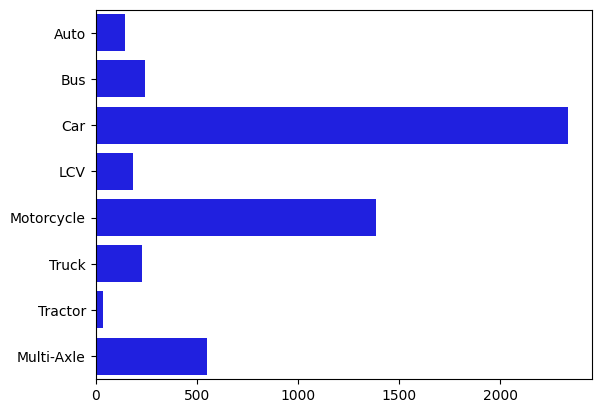

In [9]:
sns.barplot(y=classes[1:],x=list(dict_instances.values()),color="blue");

In [10]:
import torch
print(torch.cuda.get_device_name(0))

NVIDIA GeForce GTX 1650


In [11]:
from ultralytics import YOLO

model = YOLO('yolov8n.pt')

100%|██████████| 6.25M/6.25M [00:00<00:00, 13.8MB/s]


In [3]:
yaml_file_path=os.path.join(current_dir, 'data.yaml')

In [13]:
os.environ['WANDB_DISABLED'] = 'true'

In [15]:
!pip uninstall wandb

In [ ]:
results = model.train(
    data=yaml_file_path,
    epochs=50,
    imgsz=640,
    device=0,
    patience=15,
    batch=32,
    optimizer='AdamW',        # choices=[SGD, Adam, Adamax, AdamW, NAdam, RAdam, RMSProp, auto]
    lr0=0.0001,
    lrf=0.1,
    dropout=0.1,
    seed=0
)

In [4]:
from ultralytics import YOLO
model_path = os.path.join(current_dir, 'runs/detect/train/weights/best.pt')
model = YOLO(model_path)  

In [5]:
print("Current working directory:", os.getcwd())

Current working directory: d:\Traffic-classification-intensity-estimation


In [7]:
results = model.val(
    data=yaml_file_path,  # Path to your YAML data file
    imgsz=640,            # Image size for evaluation
    batch=32,             # Batch size for evaluation
    device=0              # GPU device to use
)

# Printing relevant evaluation metrics
print(f"Validation results:")
print(f"Precision: {results.box.map50:.4f}")
print(f"Recall: {results.box.map50:.4f}")
print(f"mAP@50: {results.box.map50:.4f}")
print(f"mAP@50-95: {results.box.map:.4f}")

Ultralytics 8.3.5  Python-3.10.4 torch-2.4.1+cu118 CUDA:0 (NVIDIA GeForce GTX 1650, 4096MiB)


val: Scanning D:\Traffic-classification-intensity-estimation\dataset\labels\val.cache... 1644 images, 3 backgrounds, 0 corrupt: 100%|██████████| 1644/1644 [00:00<?, ?it/s]

val: WARNING  D:\Traffic-classification-intensity-estimation\dataset\images\val\highway_3297_2020-08-26.jpg: 1 duplicate labels removed



                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:23<00:00,  2.24it/s]


                   all       1644       5121      0.755      0.794      0.828      0.581
                  Auto        133        146      0.678      0.836      0.825       0.52
                   Bus        229        246      0.808      0.804      0.843      0.649
                   Car       1175       2334      0.881      0.902      0.949      0.664
                   LCV        179        187      0.597      0.617      0.664      0.501
            Motorcycle        803       1388      0.799      0.793      0.861      0.474
                 Truck        218        229      0.681      0.717      0.763      0.614
               Tractor         38         38      0.928      0.895      0.928      0.644
            Multi-Axle        492        553      0.666      0.792      0.789      0.582
Speed: 0.6ms preprocess, 6.0ms inference, 0.0ms loss, 1.4ms postprocess per image
Results saved to runs\detect\val15
Validation results:
Precision: 0.8277
Recall: 0.8277
mAP@50: 0.8277
mAP@50-95: 0.5

In [8]:
model.export(format="engine")

WARNING  TensorRT requires GPU export, automatically assigning device=0
Ultralytics 8.3.5  Python-3.10.4 torch-2.4.1+cu118 CUDA:0 (NVIDIA GeForce GTX 1650, 4096MiB)

PyTorch: starting from 'd:\Traffic-classification-intensity-estimation\runs\detect\train\weights\best.pt' with input shape (1, 3, 640, 640) BCHW and output shape(s) (1, 12, 8400) (6.0 MB)
ONNX: export failure  63.9s: DLL load failed while importing onnx_cpp2py_export: A dynamic link library (DLL) initialization routine failed.
TensorRT: export failure  63.9s: DLL load failed while importing onnx_cpp2py_export: A dynamic link library (DLL) initialization routine failed.


Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x000001B64012B2E0>
Traceback (most recent call last):
  File "c:\Users\HP\AppData\Local\Programs\Python\Python310\lib\site-packages\torch\utils\data\dataloader.py", line 1477, in __del__
    self._shutdown_workers()
  File "c:\Users\HP\AppData\Local\Programs\Python\Python310\lib\site-packages\torch\utils\data\dataloader.py", line 1435, in _shutdown_workers
    if self._persistent_workers or self._workers_status[worker_id]:
AttributeError: '_MultiProcessingDataLoaderIter' object has no attribute '_workers_status'


ImportError: DLL load failed while importing onnx_cpp2py_export: A dynamic link library (DLL) initialization routine failed.

In [ ]:
tensorrt_model = YOLO("D://vehicle_classification//yolo//runs//detect//train//weights//best.engine")

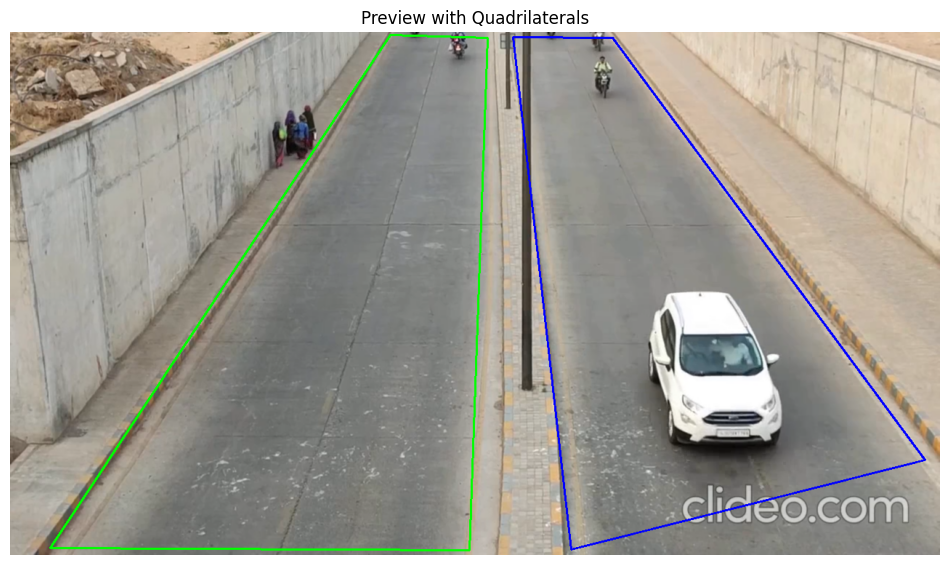

In [10]:
import numpy as np
import cv2
import matplotlib.pyplot as plt
%matplotlib inline

vertices1 = np.array([(523, 5), (55, 710), (632, 713), (657, 9)], dtype=np.int32)
vertices2 = np.array([(692, 8), (772, 712), (1259, 589), (829, 9)], dtype=np.int32)

sample_image = cv2.imread(os.path.join(current_dir, 'sample.png'))
resized_image = cv2.resize(sample_image, (1280, 720))

box_image = resized_image.copy()
box_image = cv2.cvtColor(box_image, cv2.COLOR_BGR2RGB)

cv2.polylines(box_image, [vertices1], isClosed=True, color=(0, 255, 0), thickness=2)  
cv2.polylines(box_image, [vertices2], isClosed=True, color=(0, 0, 255), thickness=2)  

plt.figure(figsize=(12, 8))
plt.imshow(box_image)
plt.title('Preview with Quadrilaterals')
plt.axis('off')
plt.show()

In [11]:
import cv2
import numpy as np

# Define a threshold for heavy traffic based on the weighted sum
heavy_traffic_threshold = 3.5  # Adjust this based on analysis

# PCU values for each vehicle type
pcu_values = {
    "Auto": 0.7,
    "Bus": 3.0,
    "Car": 1.0,
    "LCV": 1.5,
    "Motorcycle": 0.5,
    "Truck": 3.0,
    "Tractor": 2.0,
    "Multi-Axle": 4.5
}

# Define lane regions using vertices
vertices_left_lane = np.array([(523, 5), (55, 710), (632, 713), (657, 9)], dtype=np.int32)
vertices_right_lane = np.array([(692, 8), (772, 712), (1259, 589), (829, 9)], dtype=np.int32)

# Define region limits and thresholds
x1, x2 = 5, 715
lane_threshold = 670

# Text display positions
text_position_left_lane = (10, 50)
text_position_right_lane = (820, 50)
intensity_position_left_lane = (10, 210)
intensity_position_right_lane = (820, 210)

# Font settings
font = cv2.FONT_HERSHEY_SIMPLEX
font_scale = 0.8
font_color = (255, 255, 255)
background_color = (0, 0, 255)

# Load the video
cap = cv2.VideoCapture(os.path.join(current_dir, 'sample_video.mp4'))
fourcc = cv2.VideoWriter_fourcc(*'XVID')
out = cv2.VideoWriter(os.path.join(current_dir, 'sample_output.avi'), fourcc, 20.0, (int(cap.get(3)), int(cap.get(4))))

# Process each frame
while cap.isOpened():
    ret, frame = cap.read()
    if ret:
        # Copy and mask irrelevant areas of the frame
        detection_frame = frame.copy()
        detection_frame[:x1, :] = 0
        detection_frame[x2:, :] = 0

        # Perform vehicle classification
        results = model.predict(detection_frame, imgsz=640, conf=0.4)
        processed_frame = results[0].plot(line_width=1)
        processed_frame[:x1, :] = frame[:x1, :].copy()
        processed_frame[x2:, :] = frame[x2:, :].copy()

        # Draw lane boundaries
        cv2.polylines(processed_frame, [vertices_left_lane], isClosed=True, color=(0, 255, 0), thickness=2)
        cv2.polylines(processed_frame, [vertices_right_lane], isClosed=True, color=(255, 0, 0), thickness=2)

        # Initialize counters for each lane
        vehicle_counts_left_lane = {vehicle_type: 0 for vehicle_type in results[0].names.values()}
        vehicle_counts_right_lane = {vehicle_type: 0 for vehicle_type in results[0].names.values()}

        # Process detections
        for box, label in zip(results[0].boxes.xyxy, results[0].boxes.cls):
            vehicle_type = results[0].names[int(label)]
            
            # Count vehicles based on lane
            if box[0] < lane_threshold:
                vehicle_counts_left_lane[vehicle_type] += 1
            else:
                vehicle_counts_right_lane[vehicle_type] += 1

        # Calculate PCU-weighted vehicle counts for each lane
        weighted_sum_left = sum(vehicle_counts_left_lane[vt] * pcu_values.get(vt, 1) for vt in vehicle_counts_left_lane)
        weighted_sum_right = sum(vehicle_counts_right_lane[vt] * pcu_values.get(vt, 1) for vt in vehicle_counts_right_lane)

        # Determine traffic intensity based on PCU-weighted sum
        traffic_intensity_left = "Heavy" if weighted_sum_left > heavy_traffic_threshold else "Smooth"
        traffic_intensity_right = "Heavy" if weighted_sum_right > heavy_traffic_threshold else "Smooth"

        # Display vehicle counts and traffic intensity
        for i, (vehicle_type, count) in enumerate(vehicle_counts_left_lane.items()):
            cv2.putText(processed_frame, f'{vehicle_type}: {count}', (text_position_left_lane[0], text_position_left_lane[1] + i * 20), font, font_scale, font_color, 1, cv2.LINE_AA)

        for i, (vehicle_type, count) in enumerate(vehicle_counts_right_lane.items()):
            cv2.putText(processed_frame, f'{vehicle_type}: {count}', (text_position_right_lane[0], text_position_right_lane[1] + i * 20), font, font_scale, font_color, 1, cv2.LINE_AA)

        # Display traffic intensity
        cv2.putText(processed_frame, f'Traffic Intensity Left: {traffic_intensity_left}', intensity_position_left_lane, font, font_scale, font_color, 2, cv2.LINE_AA)
        pcu_position_left_lane = (intensity_position_left_lane[0], intensity_position_left_lane[1] + 40)  
        cv2.putText(processed_frame, f'PCU Left Lane: {weighted_sum_left:.2f}', pcu_position_left_lane, font, font_scale, font_color, 2, cv2.LINE_AA)
        cv2.putText(processed_frame, f'Traffic Intensity Right: {traffic_intensity_right}', intensity_position_right_lane, font, font_scale, font_color, 2, cv2.LINE_AA)
        pcu_position_right_lane = (intensity_position_right_lane[0], intensity_position_right_lane[1] + 40)  
        cv2.putText(processed_frame, f'PCU Right Lane: {weighted_sum_right:.2f}', pcu_position_right_lane, font, font_scale, font_color, 2, cv2.LINE_AA)

        out.write(processed_frame)

    else:
        break

cap.release()
out.release()


0: 384x640 1 Car, 2 Motorcycles, 52.1ms
Speed: 5.0ms preprocess, 52.1ms inference, 8.3ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 Car, 2 Motorcycles, 7.8ms
Speed: 13.5ms preprocess, 7.8ms inference, 3.0ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 Car, 2 Motorcycles, 9.5ms
Speed: 2.7ms preprocess, 9.5ms inference, 4.8ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 Car, 2 Motorcycles, 7.7ms
Speed: 12.2ms preprocess, 7.7ms inference, 1.0ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 Car, 2 Motorcycles, 9.0ms
Speed: 2.0ms preprocess, 9.0ms inference, 2.0ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 Car, 2 Motorcycles, 1.0ms
Speed: 2.9ms preprocess, 1.0ms inference, 0.0ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 Car, 2 Motorcycles, 0.0ms
Speed: 0.0ms preprocess, 0.0ms inference, 12.8ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 Car, 2 Motorcycles, 11.3ms
Sp

In [17]:
from IPython.display import Video
file = os.path.join(current_dir, 'sample_output.avi')

ffmpeg_command = f'!ffmpeg -y -loglevel panic -i "{file}" processed_sample_video3_pcu.mp4'
os.system(ffmpeg_command)

Video("processed_sample_video.mp4", embed=True, width=960)